## 1. Examine your individual flat field images for the V filter. Are there significant artifacts? How might we combine the frames into a master flat field frame to get rid of these artifacts? Compare the average light levels in your V flats and say how this will impact your combine strategy (hint: you will want to scale your flat field images to a common level, and then combine using some weighting to account for the fact that some flats have higher signal than others–it world be inappropriate to give them all equal weight). After scaling to a common mean, discuss the advantages and disadvantages of making a master flat field image from:
- <b> A straight average of all V flat frames
- <b> A straight median of all V flat frames
- <b> An average where outlier pixels are rejected if they are more than 3σ from the mean
- <b>  An average where outlier pixels are rejected and the weighted mean is obtained by weighting each image by the mean counts in the original image. This way, bright flats field exposures with higher count rates are given more weight than flats with low light levels. Which of these strategies, if any, is the best? Or is some combination the right approach? Show plots and metrics like RMS to defend your conclusions.

Import block with necessary packages.

In [4]:
# import block
import numpy as np
from astropy.io import fits
from matplotlib import pyplot as plt
from matplotlib import rc
%matplotlib inline
from astropy.visualization import hist
from ccdproc import ImageFileCollection
import ccdproc as ccdp
from astropy.modeling import fitting
from astropy.modeling.models import Polynomial1D,Chebyshev1D,Legendre1D,Hermite1D
from astropy.nddata import CCDData
from datetime import datetime
from astropy.stats import sigma_clip
from astropy.modeling import models as mod

In [5]:
# import convenience plotting functions downloaded from 
# here: https://github.com/mwcraig/ccd-reduction-and-photometry-guide
phot_tutorial_dir = '/Users/marykaldor/Software/py/ccd-reduction-and-photometry-guide/notebooks/'
import sys
sys.path.insert(0,phot_tutorial_dir)
from convenience_functions import show_image

In [6]:
# for imaging, I like the photometry notebook plot defaults
# so use their custom style for larger fonts and figures
plt.style.use('/Users/marykaldor/Software/py/ccd-reduction-and-photometry-guide/notebooks/guide.mplstyle')

# set a couple more default parameters for the plots below
rc('font', size=20)
rc('axes', grid=True)

In [16]:
def inv_median(x):
    return 1./np.median(x)

def inv_mean(x):
    return 1./np.mean(x)

def inv_mode(x):
    return 1./stats.mode(x,axis=None)[0][0]

Grab V band flats from the initial data directory, turn them into CCD objects and check out their appearance. The maximum counts appear to be between 10000 and 40000 counts, so there is a large range between the frame. Some areas are higher in count than other areas, and there are a few stars that we will need to get rid of before using these in reduction of science frames. There are 7 V flat frames in total.

['/Users/marykaldor/Imaging/a043.fits', '/Users/marykaldor/Imaging/a044.fits', '/Users/marykaldor/Imaging/a045.fits', '/Users/marykaldor/Imaging/a046.fits', '/Users/marykaldor/Imaging/a047.fits', '/Users/marykaldor/Imaging/a048.fits', '/Users/marykaldor/Imaging/a049.fits']


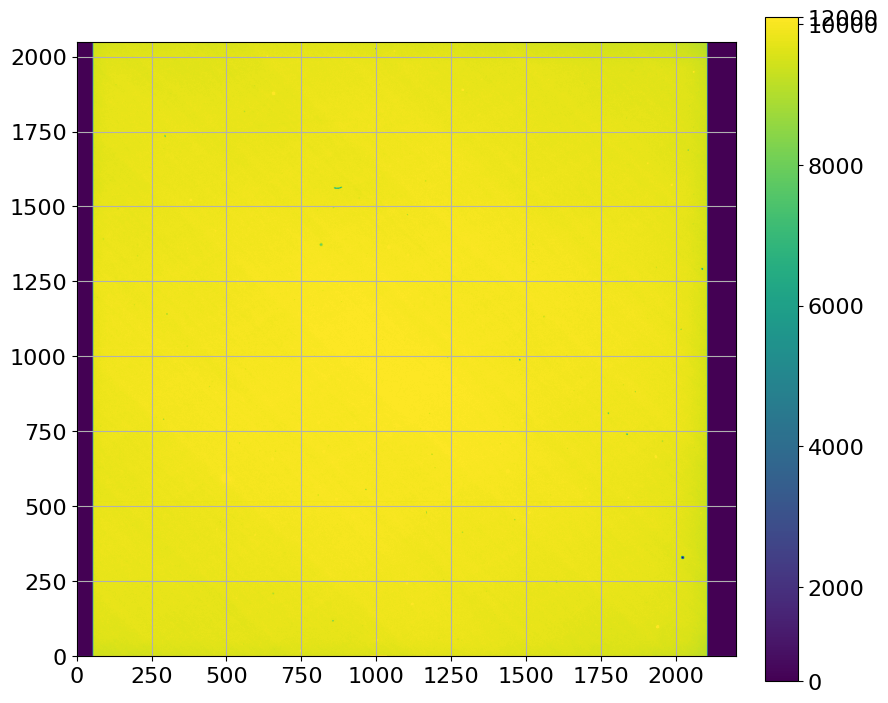

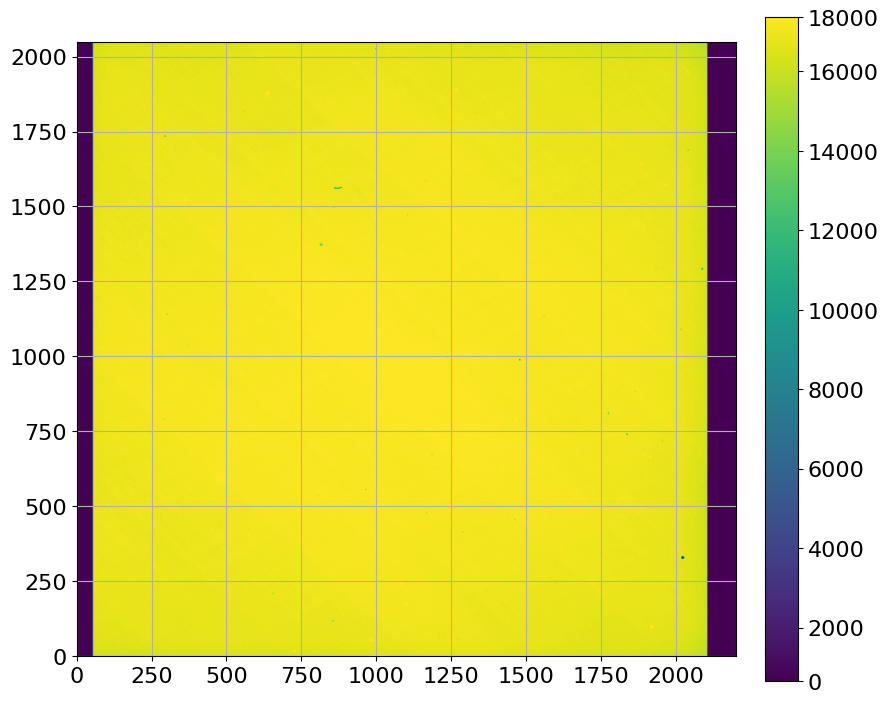

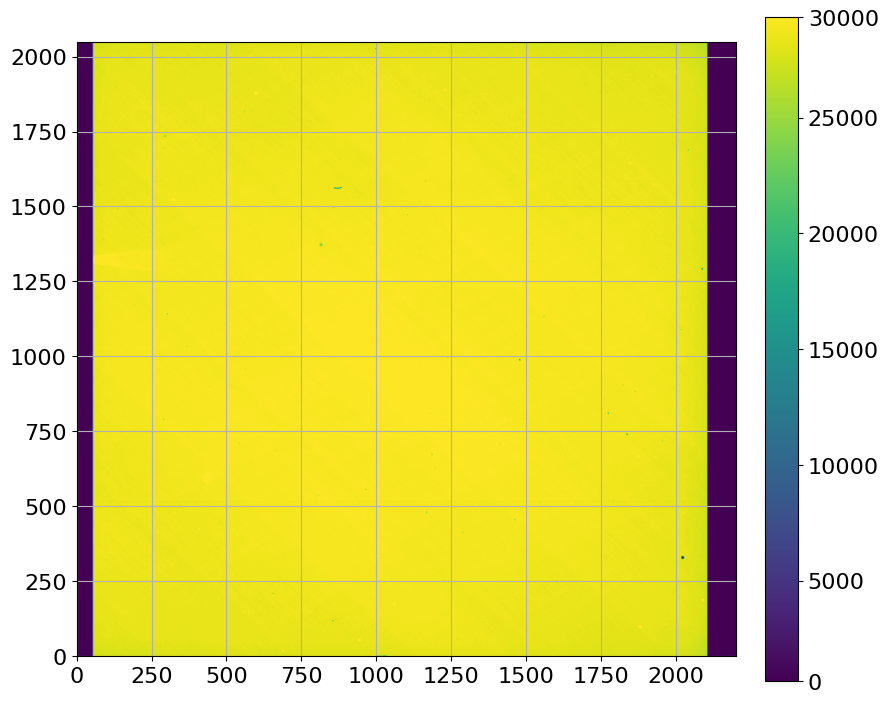

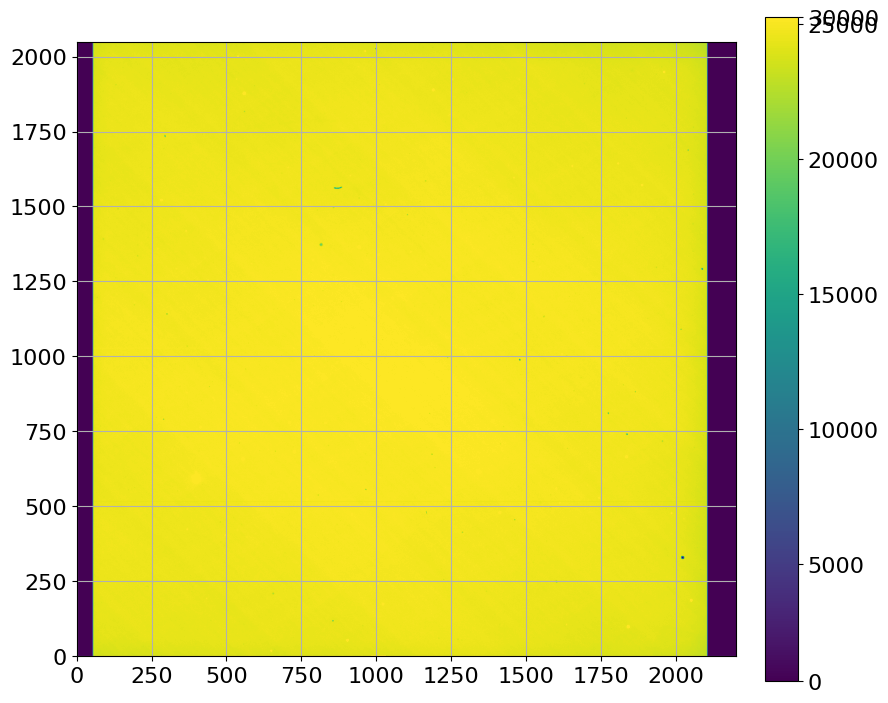

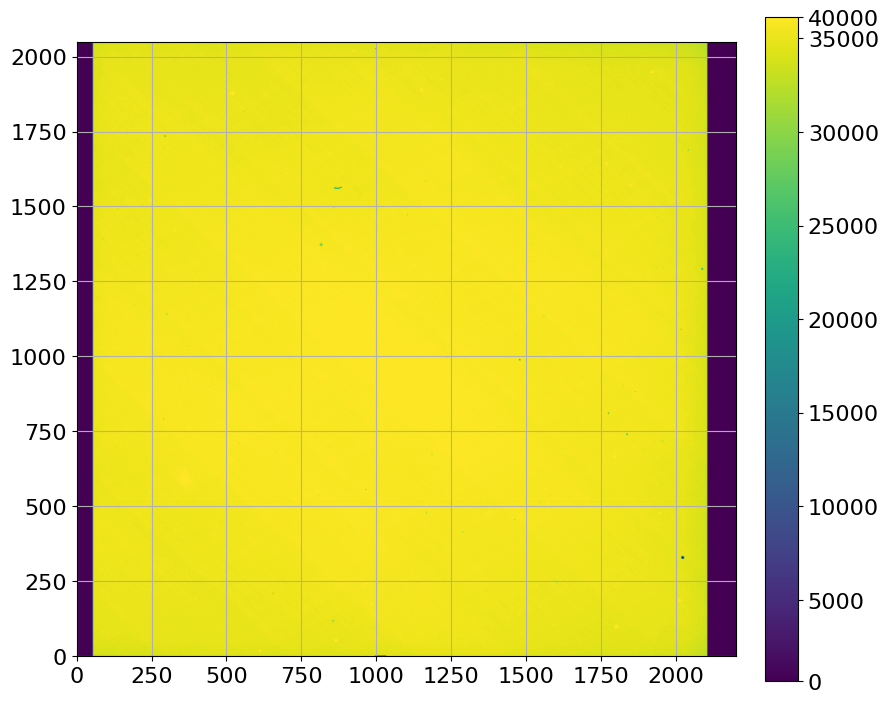

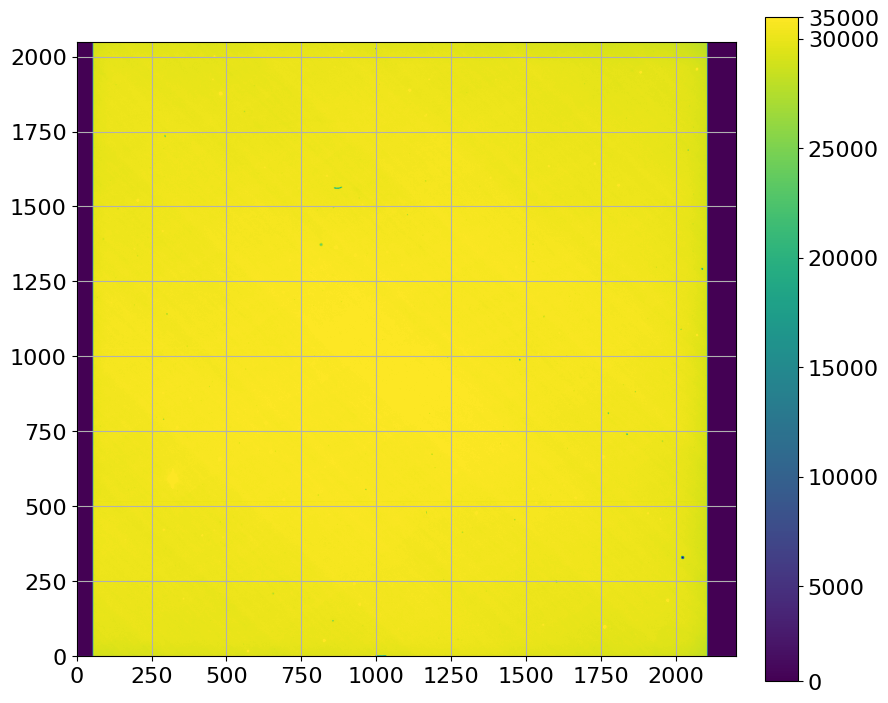

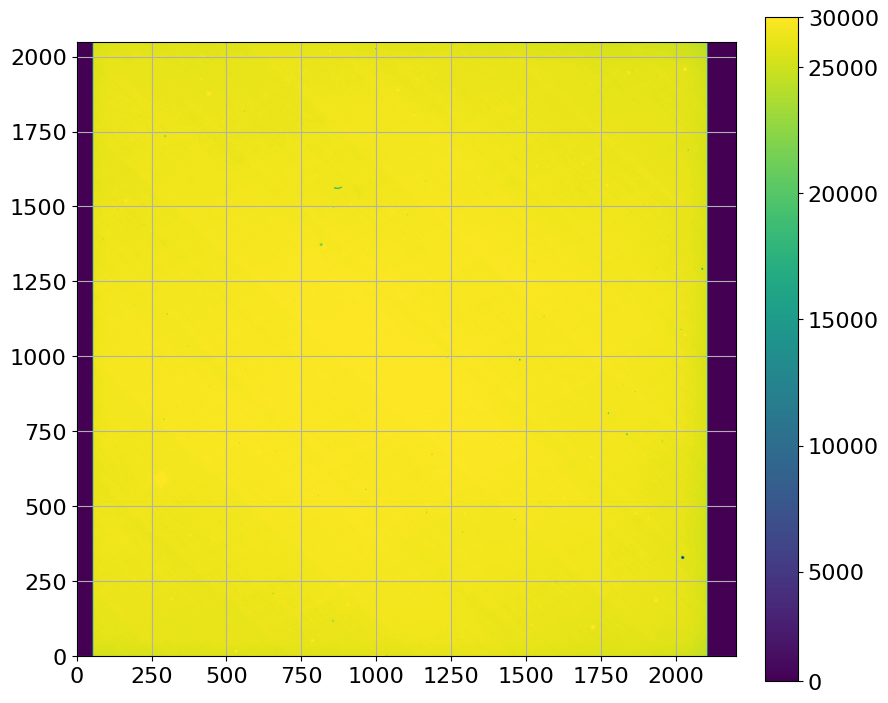

In [7]:
import ccdproc as ccdp
data_dir = "/Users/marykaldor/Imaging/"

v_flat_files = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(43,50)] # forms a list of strings
print(v_flat_files)
vflathdu = [fits.open(file) for file in v_flat_files] # forms a list of header objects
vflatdata = [item[0].data for item in vflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
vflatccd = [CCDData(img, unit="adu") for img in vflatdata]

for file in vflatccd:
    show_image(file)

Reduce V flat frames and normalize them. I created the mean normalized flat and median normalized flat without any sigma clipping. I also tried recombining the flats with a weight of the normalization factor (mean value of a frame before normalizing) and looked at what that might look like. The effect of dithering is obvious as the stars appear to hop along horizontally when images are combined.

7
(7, 2048, 2048)


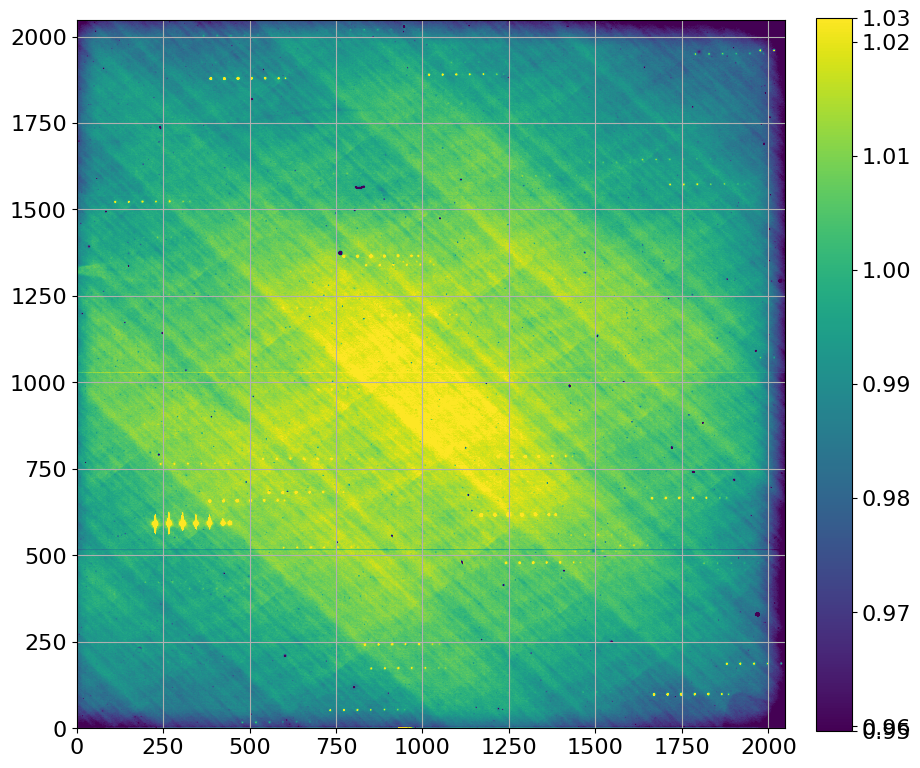

In [18]:
vflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in vflatccd]
vflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in vflatsub]
norms = [np.mean(frame) for frame in vflatsubtrim]
print(len(norms))
scaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(vflatsubtrim, norms)]
print(np.shape(scaled))
meanscaled = np.mean(scaled, axis=0)
medscaled = np.median(scaled, axis=0)
meanmastervflat = np.mean(vflatsubtrim,axis=0)
medmastervflat = np.median(vflatsubtrim,axis=0)
weighted = CCDData(np.average(scaled, weights=norms, axis=0), unit="adu")
show_image(weighted)

Calculated means and medians of all frames and looked at the difference in values. While there are differences, the differences are quite small compared to the total counts, which is why it is hard to see the difference between means and medians on the plot below.

means [9190.478658573973, 16305.532510003264, 28042.16879040855, 24053.17738772897, 34689.97589654337, 29643.48536081701, 25731.266116915936] 

medians [9199.49018950713, 16323.83088803093, 28076.641229156234, 24081.431139775676, 34732.858840755216, 29678.904907876728, 25760.733633072858] 

difference [ 9.01153093 18.29837803 34.47243875 28.25375205 42.88294421 35.41954706
 29.46751616] 

mean of mean master flat 23950.869245855873
mean of median master flat 25728.27687468224


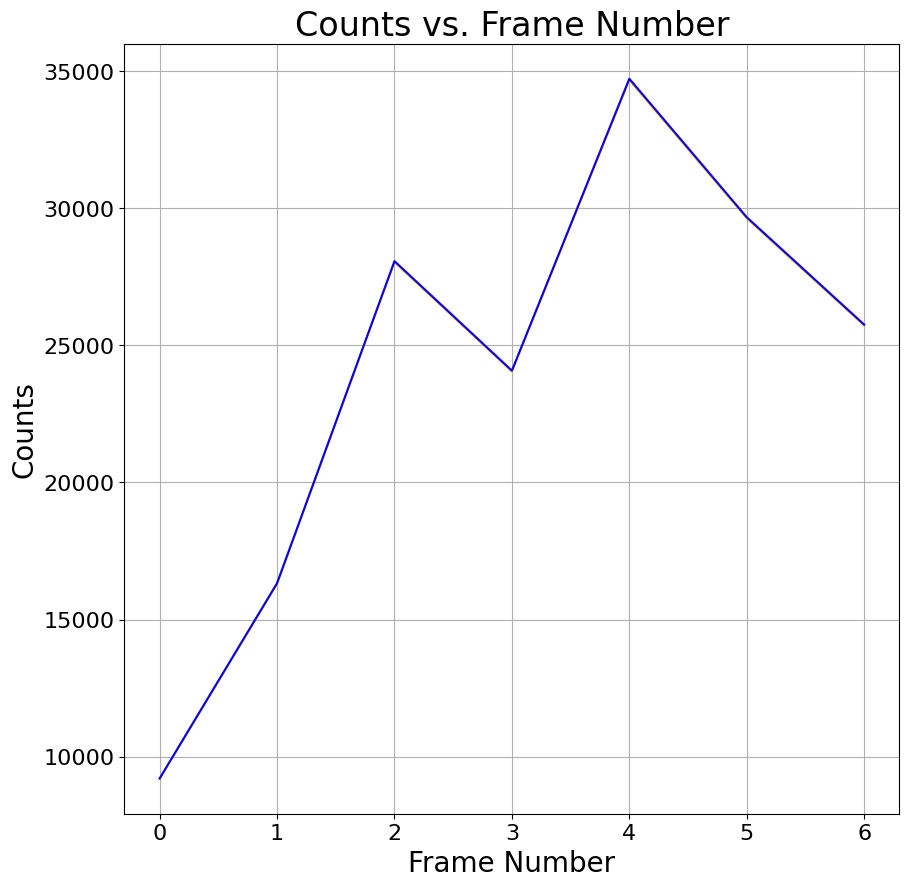

In [19]:
flatmeans = [np.mean(frame) for frame in vflatsubtrim] # same as "norms" variable above
flatmeds = [np.median(frame) for frame in vflatsubtrim]
print("means", flatmeans, "\n")
print("medians", flatmeds, "\n")
diff = np.subtract(flatmeds, flatmeans)
print("difference", diff, "\n")
meanmastermean = np.mean(meanmastervflat)
meanmastermed = np.mean(medmastervflat)
print("mean of mean master flat", meanmastermean)
print("mean of median master flat", meanmastermed)
plt.plot(np.arange(len(flatmeans)), flatmeans, color="orange")
plt.plot(np.arange(len(flatmeds)), flatmeds, color="blue")
plt.xlabel("Frame Number")
plt.ylabel("Counts")
plt.title("Counts vs. Frame Number")
plt.show()

Here I demonstrated why the median is not helpful. There are 7 total flats, so the median frame should be approximately the 4th frame in terms of average value, or the 7th frame overall (index 6 in the list due to the 0th index at the beginning). I showed how the mean frame appears to be unique, but the median frame and the 7th overall flat frame appear to be nearly the same image with a difference of 0 counts for most pixels. The median is not a very good representative of what all flats are doing here, so I won't be using it. The mean appears to be better, but it can be improved.

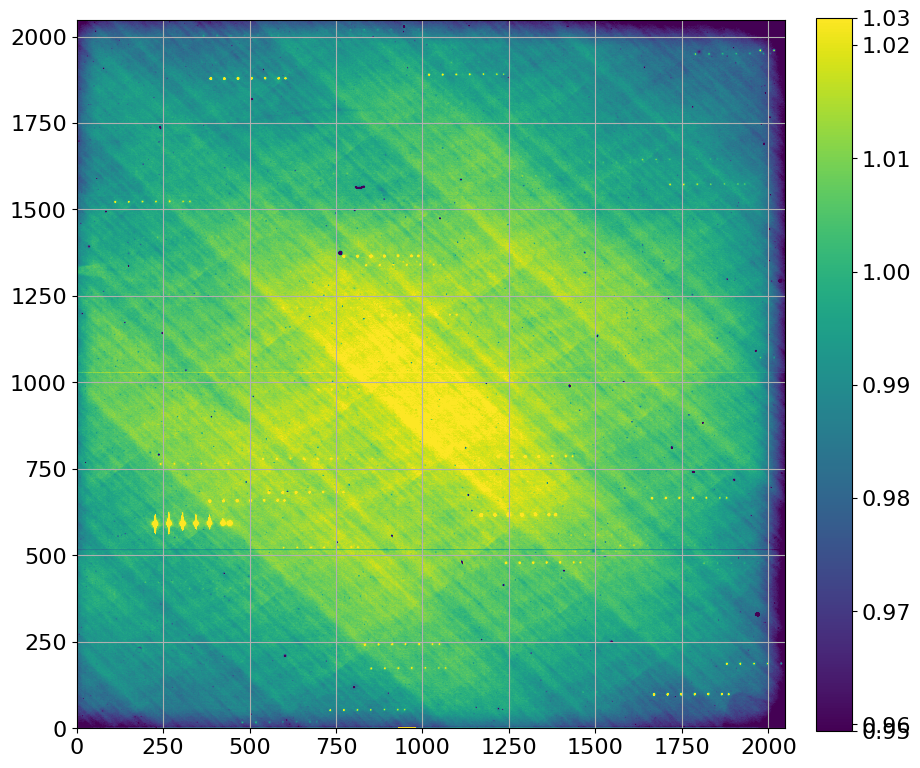

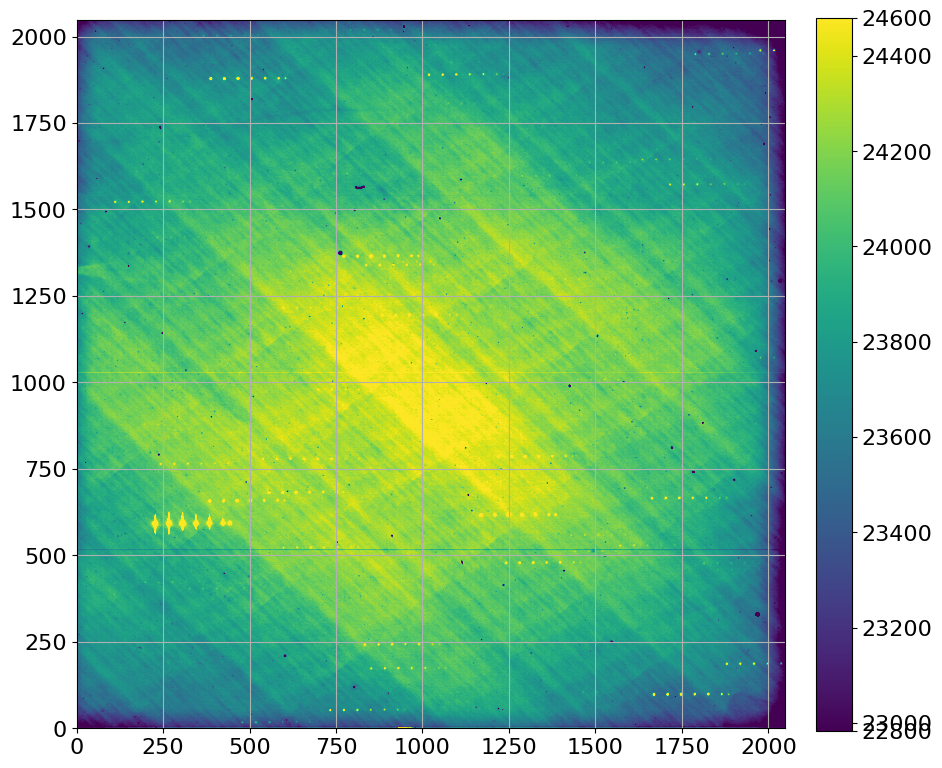

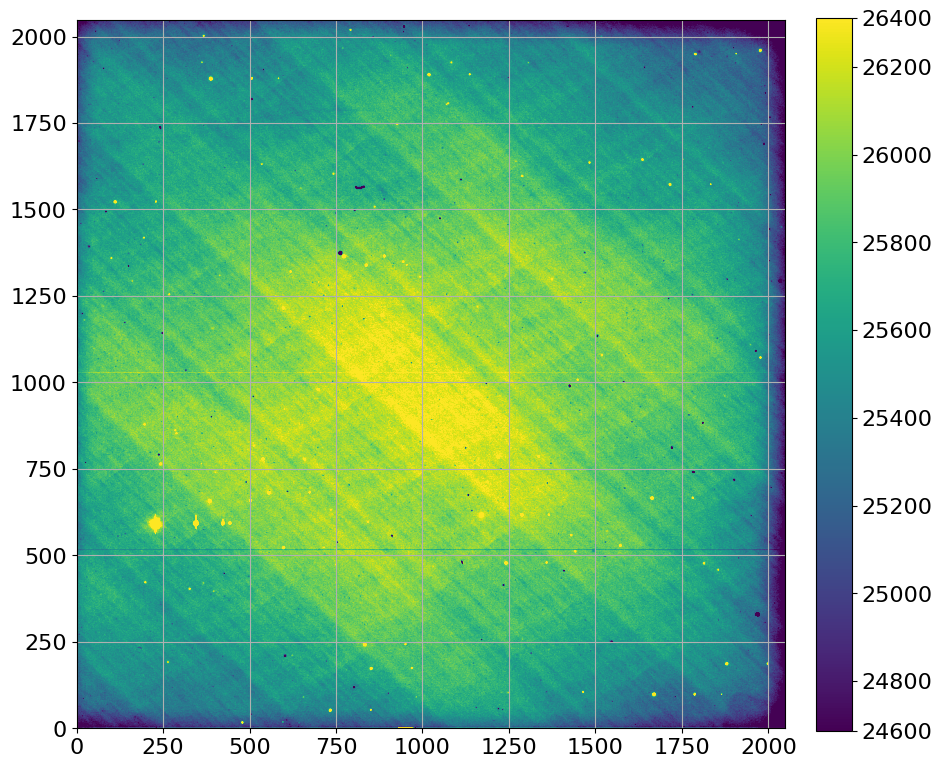

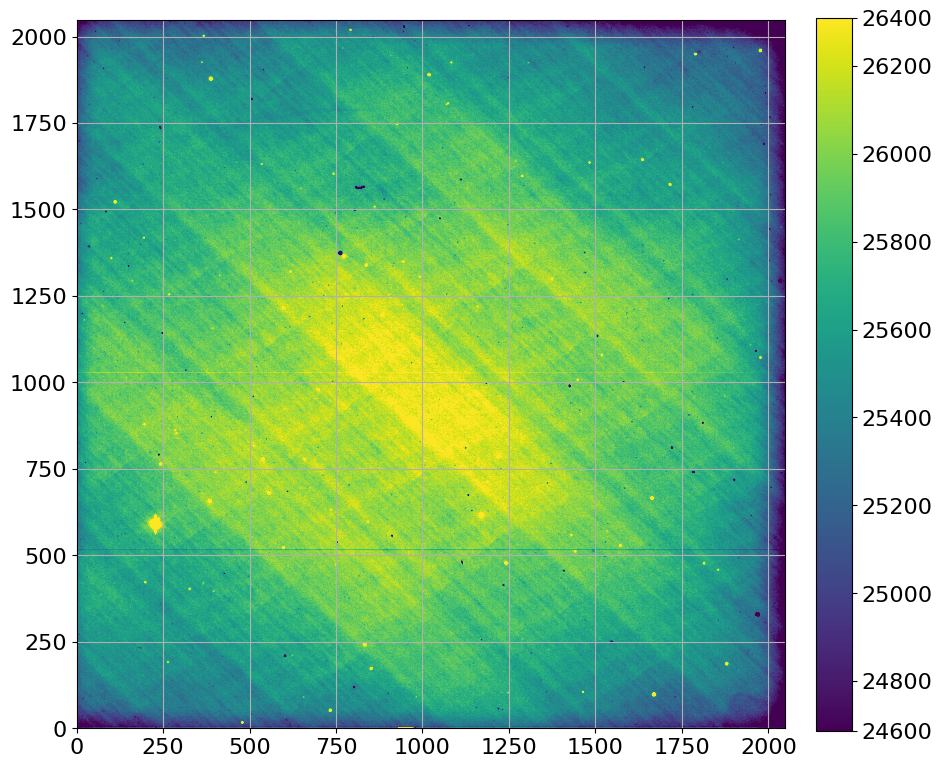

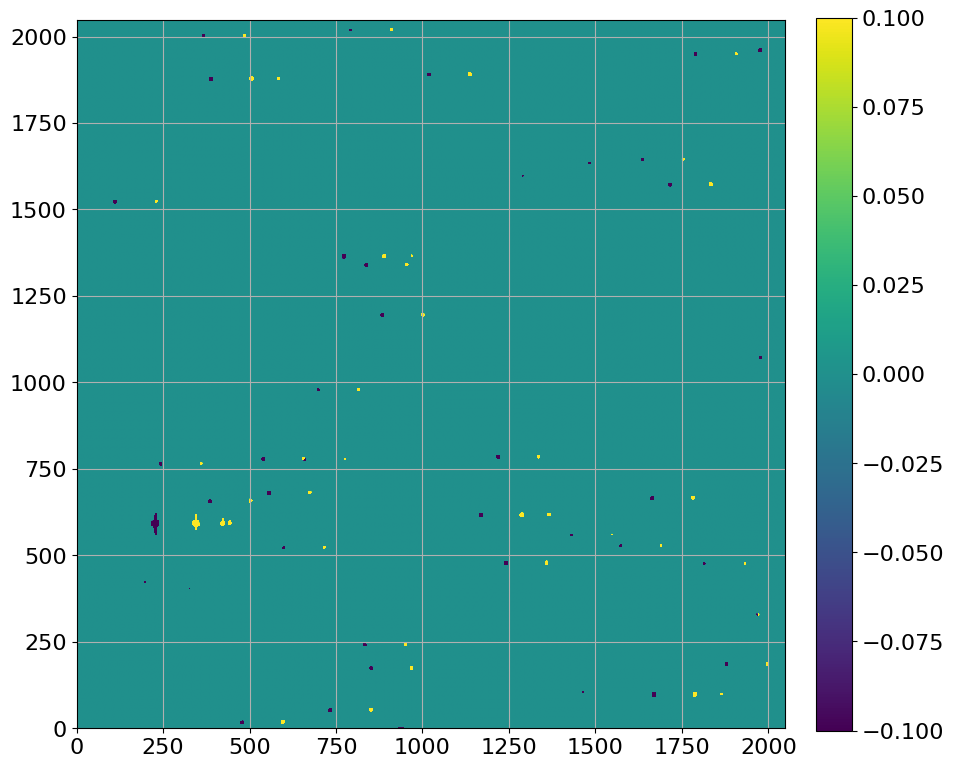

In [20]:
test = medmastervflat-vflatsubtrim[6]
show_image(meanscaled)
show_image(meanmastervflat)
show_image(medmastervflat)
show_image(vflatsubtrim[6])
show_image(test)
# There are stars in here that we'd like to get rid of
# We see the effects of dithering as well
# There are also random dark spots

These are the RMS calculations for the mean and median master flats. The mean has a slightly lower RMS, peaking around 24200 counts, while the median is closer to 26000 counts at its peak.

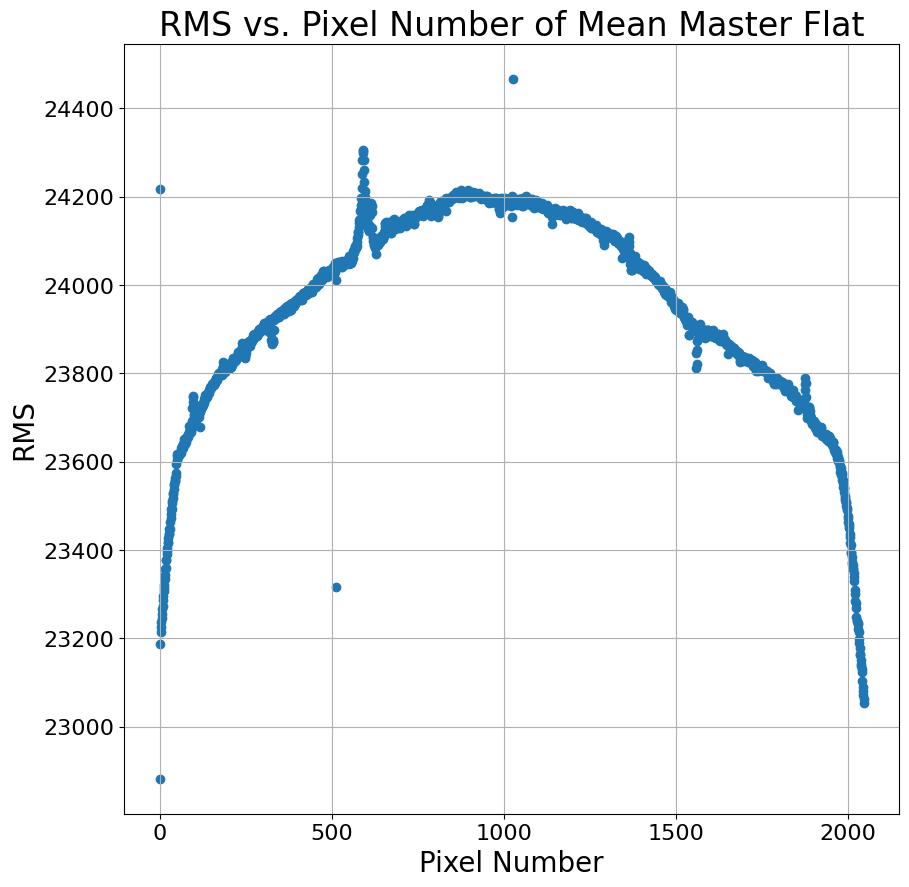

This image has mean 23950.869245855873 and RMS 23952.5377780833


In [21]:
mean_meansq = np.mean(meanmastervflat**2, axis=1)
mean_rms = np.sqrt(mean_meansq)
row = np.arange(2048)
plt.scatter(row, mean_rms)
plt.xlabel("Pixel Number")
plt.ylabel("RMS")
plt.title("RMS vs. Pixel Number of Mean Master Flat")
plt.show()
print("This image has mean", meanmastermean, "and RMS", np.mean(mean_rms))

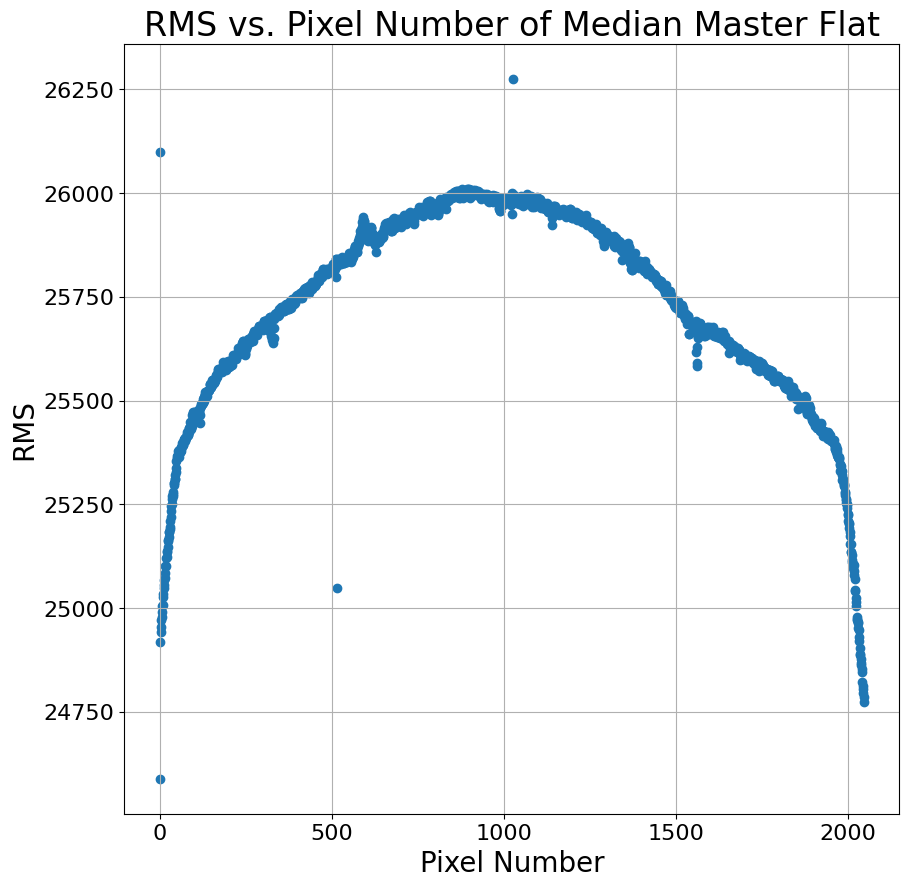

This image has mean 25728.27687468224 and RMS 25730.160694722945


In [22]:
med_meansq = np.mean(medmastervflat**2, axis=1)
med_rms = np.sqrt(med_meansq)
row = np.arange(2048)
plt.scatter(row, med_rms)
plt.xlabel("Pixel Number")
plt.ylabel("RMS")
plt.title("RMS vs. Pixel Number of Median Master Flat")
plt.show()
print("This image has mean", meanmastermed, "and RMS", np.mean(med_rms))

I bring in sigma clipping here. 3 sigma seems to be too aggressive, as the difference between the unclipped image and the clipped image quickly went to zero. This suggests that most pixels (including those where stars are) are under 3 sigma away from the mean of each flat frame, which is why very little gets taken away. This makes these frames good flats, but we do not need to have a 3 sigma cut.

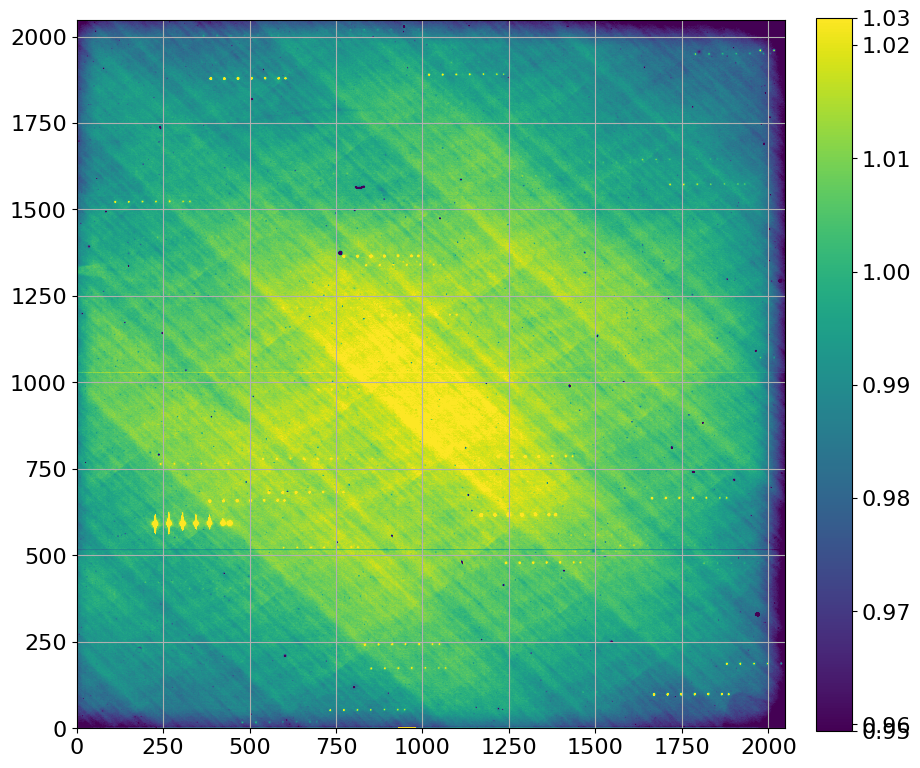

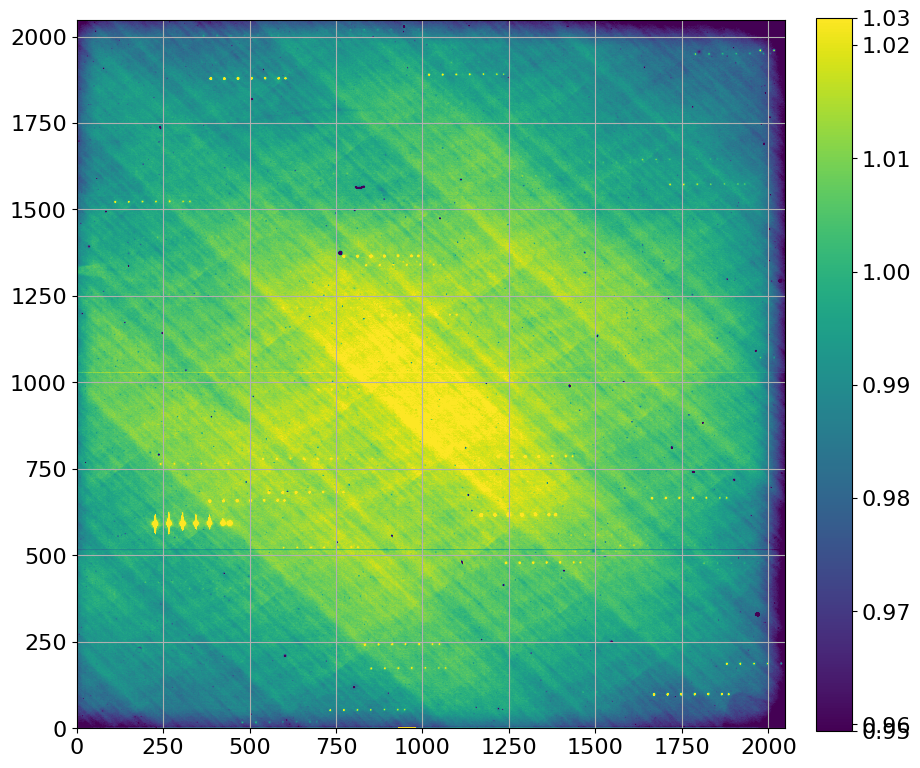

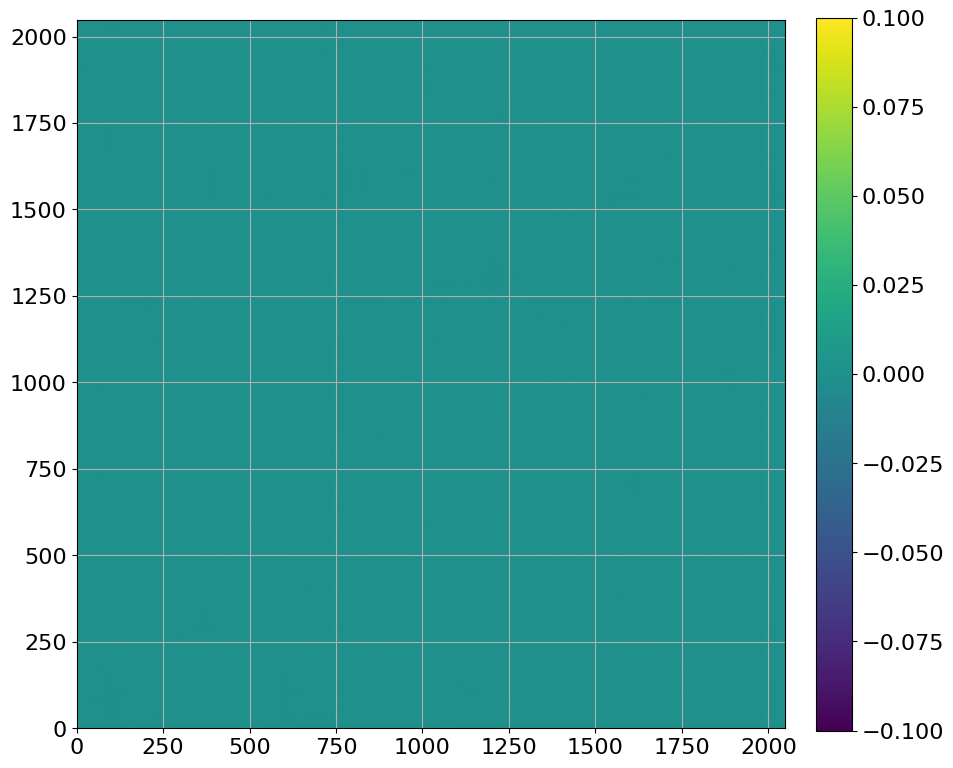

In [23]:
# 3sigma was too many!!!!
sigclip3 = ccdp.combine(scaled, method="average", sigma_clip=True, sigma_clip_low_thresh=3, sigma_clip_high_thresh=3)
show_image(meanscaled)
show_image(sigclip3)
sigdif3 = meanscaled-sigclip3
show_image(sigdif3)

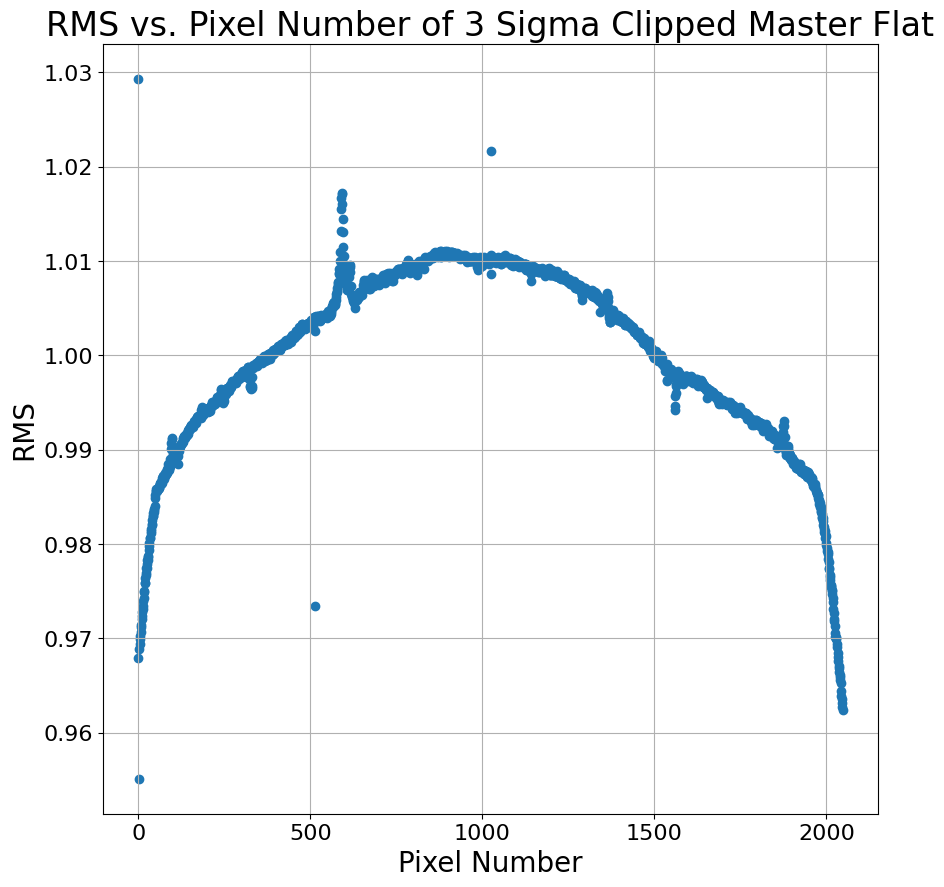

This image has mean 0.9999999999999994 and RMS 1.0000753139569447


In [24]:
sc3_meansq = np.mean(np.asarray(sigclip3)**2, axis=1)
sc3_rms = np.sqrt(sc3_meansq)
row = np.arange(2048)
plt.scatter(row, sc3_rms)
plt.xlabel("Pixel Number")
plt.ylabel("RMS")
plt.title("RMS vs. Pixel Number of 3 Sigma Clipped Master Flat")
plt.show()
meansc3 = np.mean(sigclip3)
print("This image has mean", meansc3, "and RMS", np.mean(sc3_rms))

2 sigma clipping was much more effective! I seem to lose almost all stars and other random spots but keep the pattern of the overall flat. I suggest using this approach to flats in the other steps because all stars are removed without having any bizarre light OR dark spots.

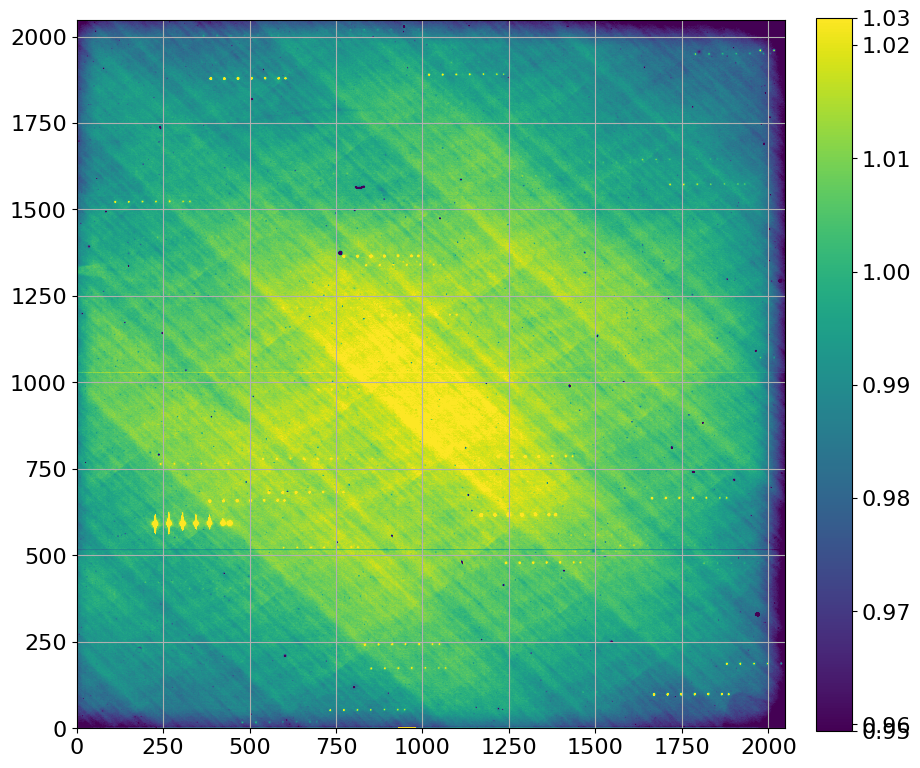

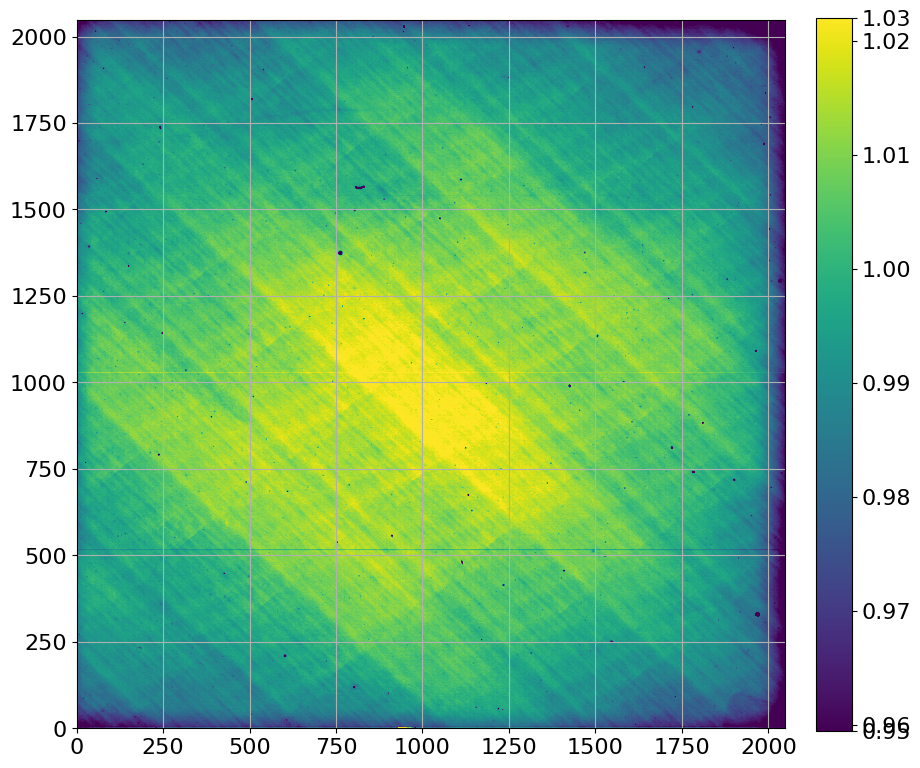

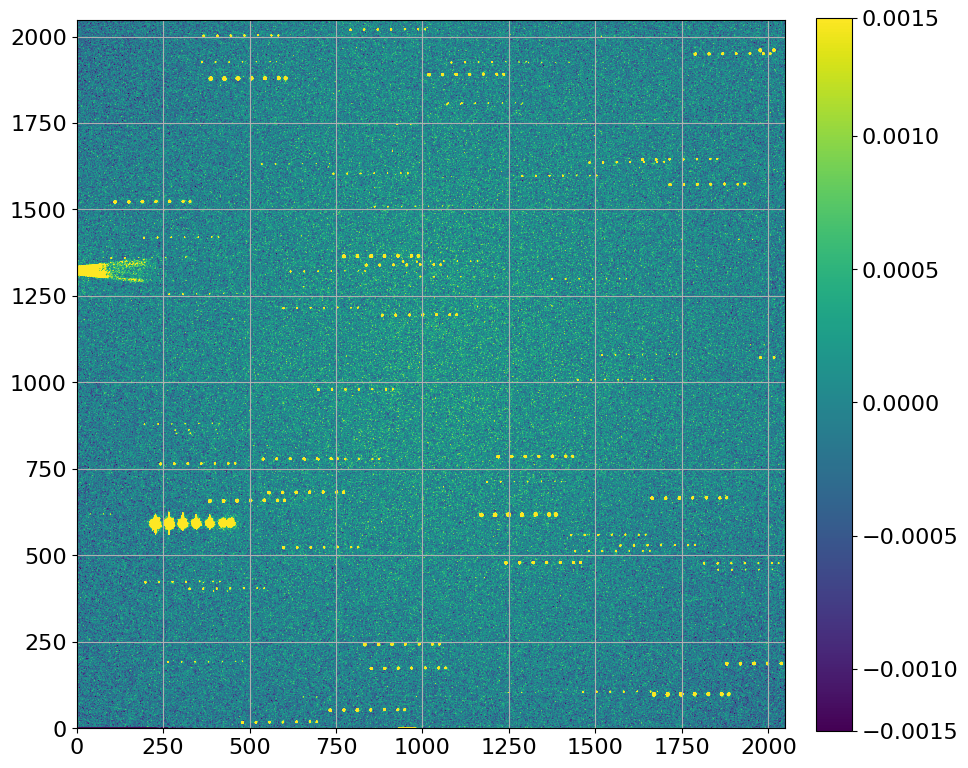

In [25]:
sigclip2 = ccdp.combine(scaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
show_image(meanscaled)
show_image(sigclip2)
sigdif2 = meanscaled-sigclip2
show_image(sigdif2)
sigclip2.write("/Users/marykaldor/reduced/vflatmaster.fits", overwrite="True")
vmasterflat = sigclip2

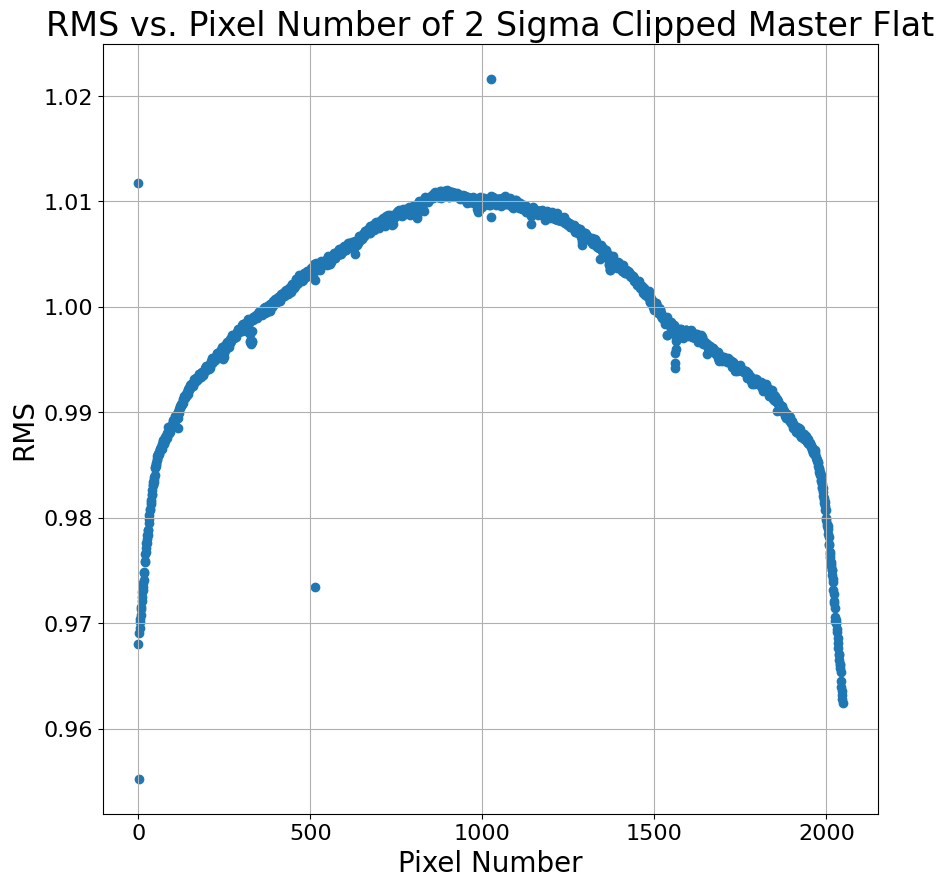

This image has mean 0.9998611205811608 and RMS 0.9999226465202671


In [26]:
sc2_meansq = np.mean(np.asarray(sigclip2)**2, axis=1)
sc2_rms = np.sqrt(sc2_meansq)
row = np.arange(2048)
plt.scatter(row, sc2_rms)
plt.xlabel("Pixel Number")
plt.ylabel("RMS")
plt.title("RMS vs. Pixel Number of 2 Sigma Clipped Master Flat")
plt.show()
meansc2 = np.mean(sigclip2)
print("This image has mean", meansc2, "and RMS", np.mean(sc2_rms))

When I looked at having a weighed recombine of images, I thought that this would be more effective because it is what we suggested in class. However, there are dark spots that appear where the stars used to be (or at least at similar distances with respect to one another). This seems counterproductive, because as much as we want to make sure we are not leaving light spots behind, we also don't want to create phantom dark spots that were never there to begin with. This seems as if I have gone too far in the other direction when I tried to correct. Despite this being the suggested appraoch in class, I don't want to use these images moving forward because they don't look very "flat" for being flat images.

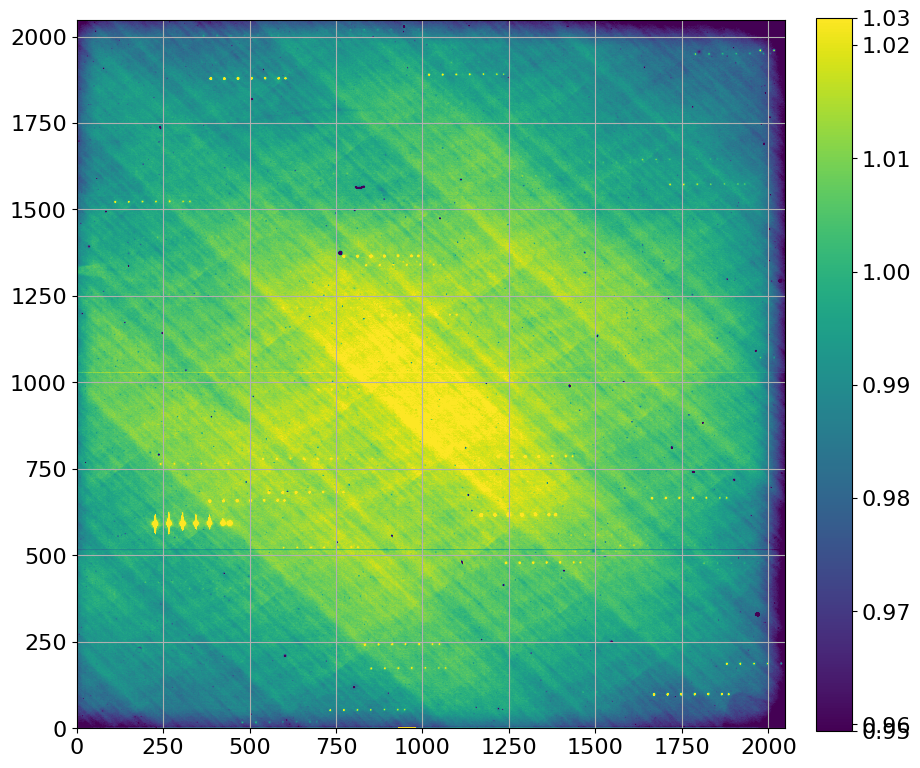

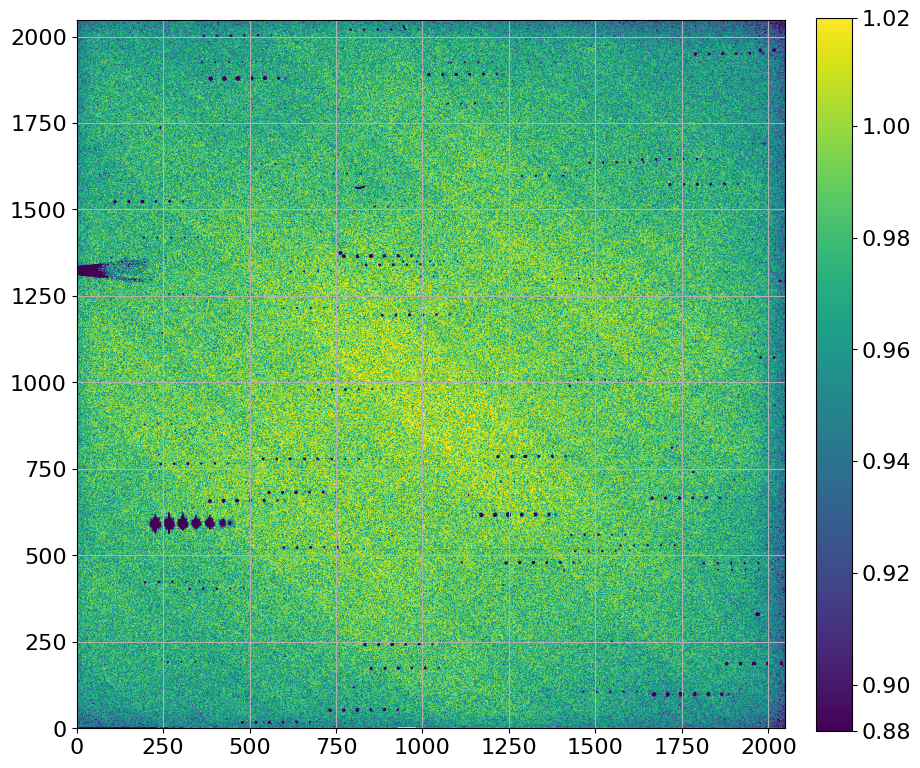

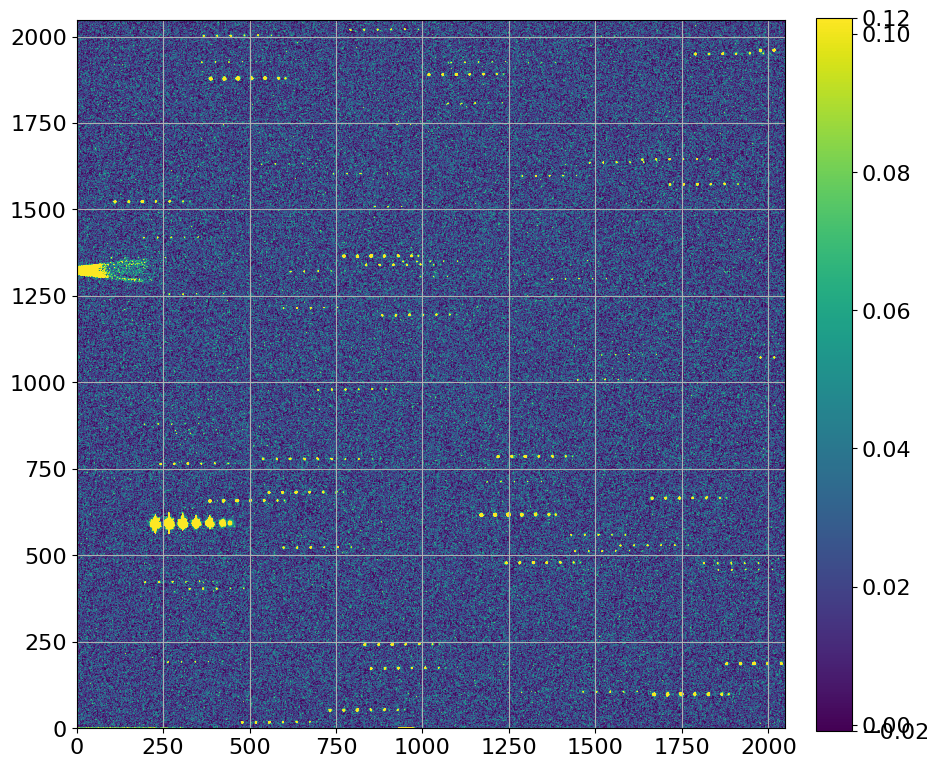

In [27]:
sigclip2w = ccdp.combine(scaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2, weights=np.asarray(vflatsubtrim))
show_image(meanscaled)
show_image(sigclip2w)
sigdif2w = meanscaled-sigclip2w
show_image(sigdif2w)

This was a different approach to the same weighted recombine attempt. I wanted to check that I wasn't doing something funky myself, but it seems like the weighted recombine master flat just looks like that? I compared each of the weighted recombines to each other as well as found a very slight difference between them - would love to discuss where that comes from.

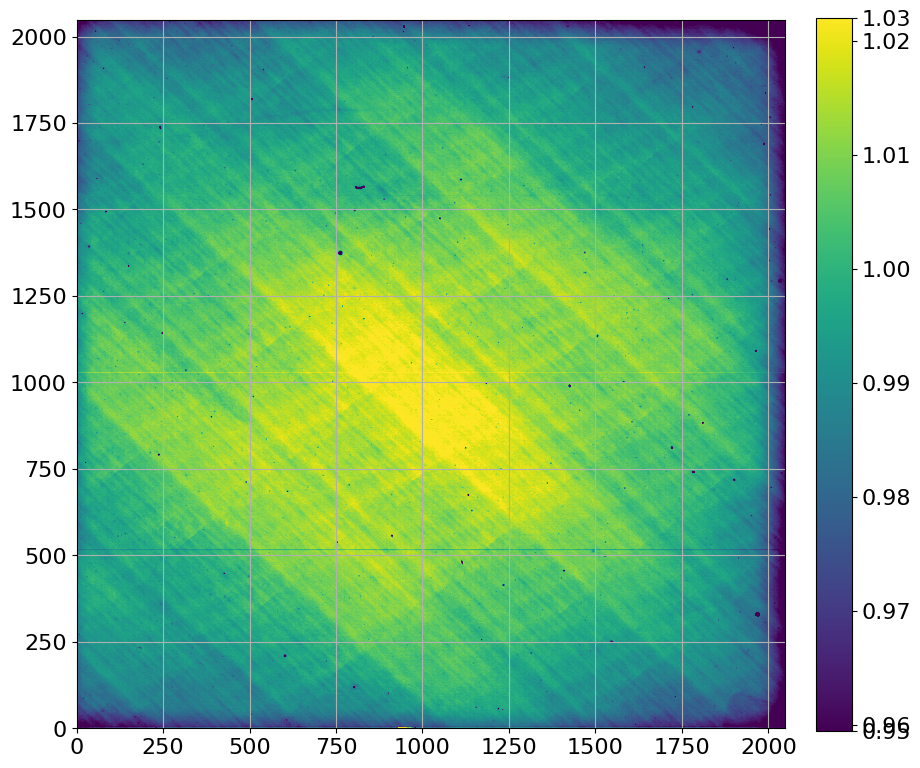

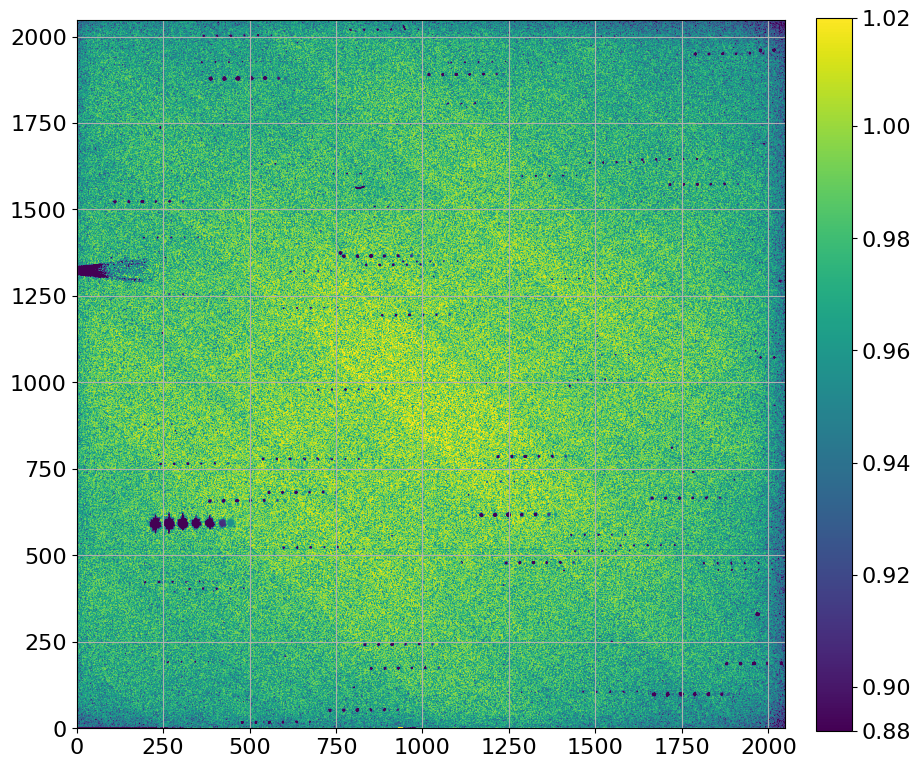

In [28]:
sigclip2w_recombine = ccdp.Combiner(scaled)
sigclip2w_recombine.sigma_clipping(low_thresh=2, high_thresh=2)
intermediate = sigclip2w_recombine.average_combine() 
show_image(intermediate)
sigclip2w_recombine.weights = np.asarray(norms)
combine_weighted_by_image = sigclip2w_recombine.average_combine() 
show_image(combine_weighted_by_image)

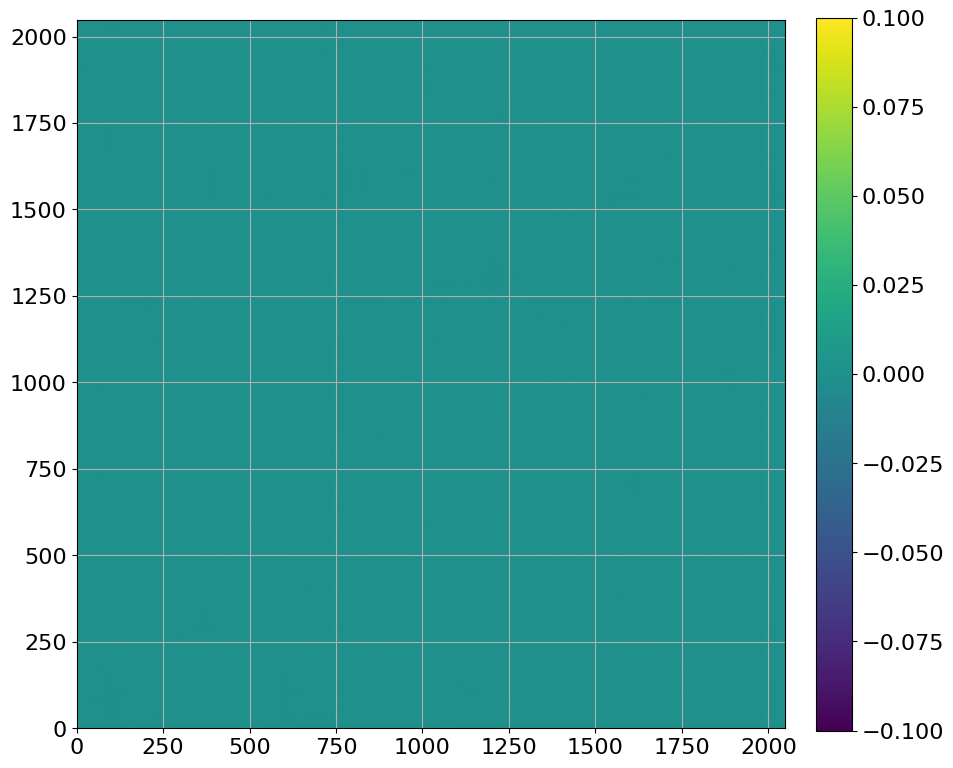

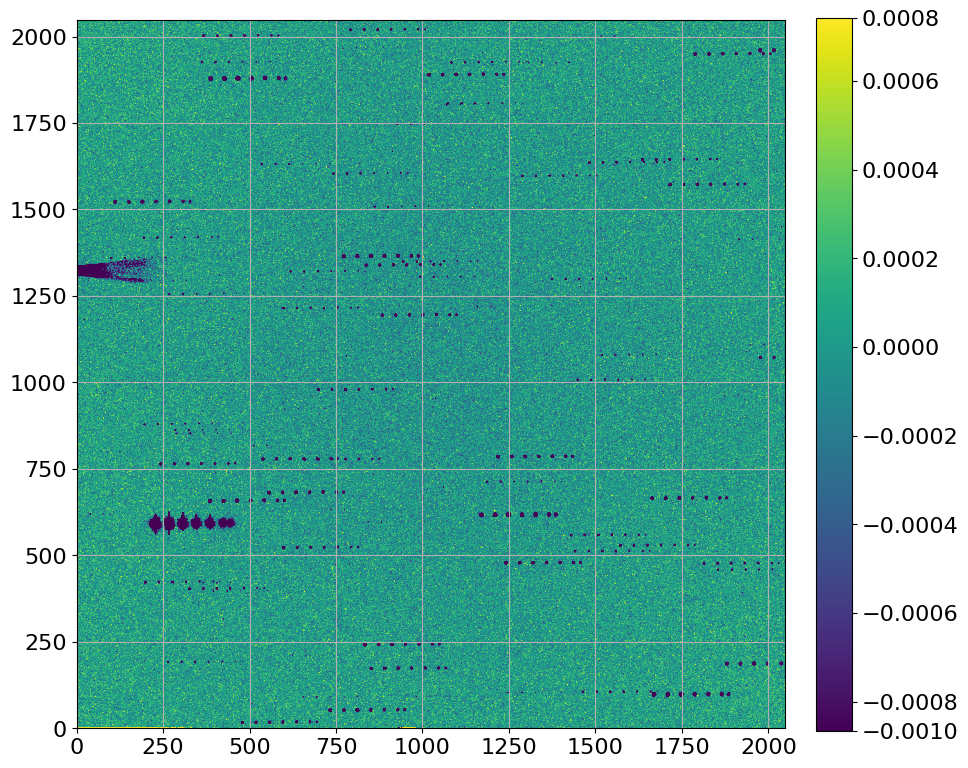

In [29]:
diff_sigclip2 = CCDData(np.asarray(sigclip2) - np.asarray(intermediate), unit="adu")
show_image(diff_sigclip2)
diff_sigclip2w = CCDData(np.asarray(sigclip2w) - np.asarray(combine_weighted_by_image), unit="adu")
show_image(diff_sigclip2w)

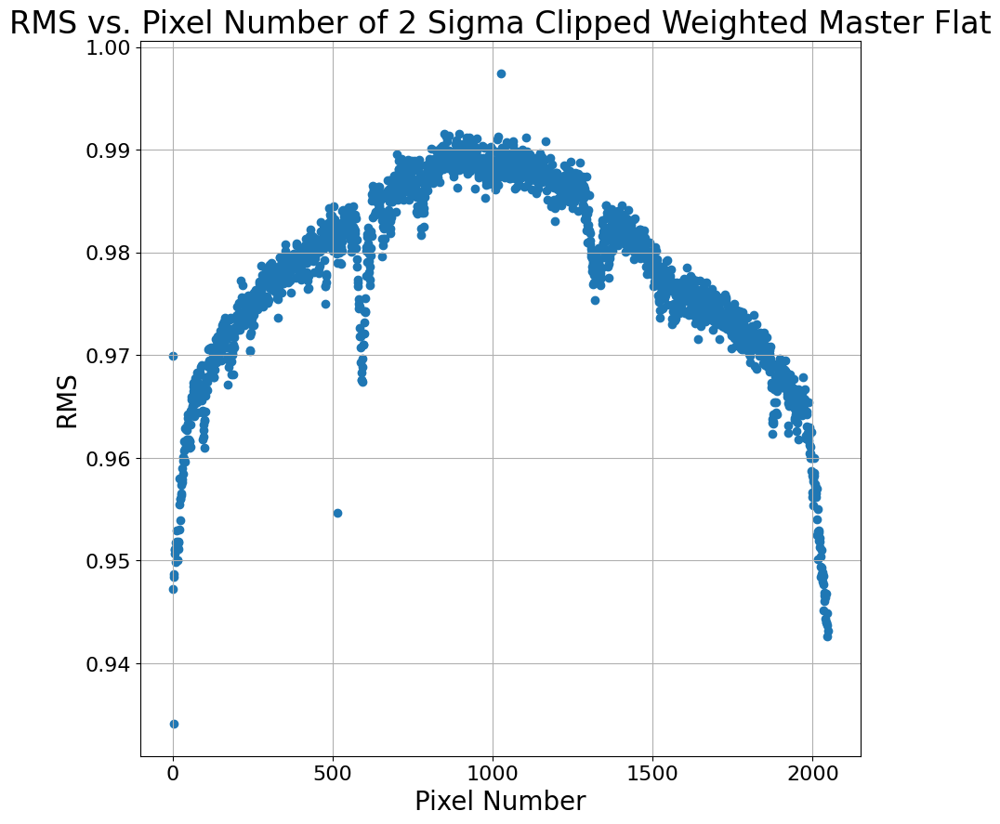

This image has mean 0.976823569077024 and RMS 0.9781342445132462


In [30]:
sc2w_meansq = np.mean(np.asarray(sigclip2w)**2, axis=1)
sc2w_rms = np.sqrt(sc2w_meansq)
row = np.arange(2048)
plt.scatter(row, sc2w_rms)
plt.xlabel("Pixel Number")
plt.ylabel("RMS")
plt.title("RMS vs. Pixel Number of 2 Sigma Clipped Weighted Master Flat")
plt.show()
meansc2w = np.mean(sigclip2w)
print("This image has mean", meansc2w, "and RMS", np.mean(sc2w_rms))

## 2. Combine your flat field images to make a master flat for all filters using the strategy that you arrived at above.

Grab all flat files for other filters, pull their data, reduce them, normalize them, and combine them with an unweighted 2 sigma clipped mean combine to get all my master flats for each filter! I made sure to save them this time as well. :)

In [10]:
halphaflatfiles = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(5,21)] # forms a list of strings
uflatfiles = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(21,29)] # forms a list of strings
bflatfiles = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(29,43)] # forms a list of strings
rflatfiles = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(50,56)] # forms a list of strings
iflatfiles = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(56,63)] # forms a list of strings
domeflatfiles = [data_dir+"g"+str(num).zfill(3)+".fit" for num in np.arange(1,4)] # forms a list of strings

In [32]:
halphaflathdu = [fits.open(file) for file in halphaflatfiles] # forms a list of header objects
halphaflatdata = [item[0].data for item in halphaflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
halphaflatccd = [CCDData(img, unit="adu") for img in halphaflatdata]
halphaflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in halphaflatccd]
halphaflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in halphaflatsub]
halphanorms = [np.mean(frame) for frame in halphaflatsubtrim]
halphascaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(halphaflatsubtrim, halphanorms)]
halphamasterflat = ccdp.combine(halphascaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
halphamasterflat.write("/Users/marykaldor/reduced/halphaflatmaster.fits", overwrite="True")

In [33]:
uflathdu = [fits.open(file) for file in uflatfiles] # forms a list of header objects
uflatdata = [item[0].data for item in uflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
uflatccd = [CCDData(img, unit="adu") for img in uflatdata]
uflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in uflatccd]
uflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in uflatsub]
unorms = [np.mean(frame) for frame in uflatsubtrim]
uscaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(uflatsubtrim, unorms)]
umasterflat = ccdp.combine(uscaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
umasterflat.write("/Users/marykaldor/reduced/uflatmaster.fits", overwrite="True")

In [11]:
bflathdu = [fits.open(file) for file in bflatfiles] # forms a list of header objects
bflatdata = [item[0].data for item in bflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
bflatccd = [CCDData(img, unit="adu") for img in bflatdata]
bflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in bflatccd]
bflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in bflatsub]
bnorms = [np.mean(frame) for frame in bflatsubtrim]
bscaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(bflatsubtrim, bnorms)]
bmasterflat = ccdp.combine(bscaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
bmasterflat.write("/Users/marykaldor/reduced/bflatmaster.fits", overwrite="True")

In [36]:
rflathdu = [fits.open(file) for file in rflatfiles] # forms a list of header objects
rflatdata = [item[0].data for item in rflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
rflatccd = [CCDData(img, unit="adu") for img in rflatdata]
rflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in rflatccd]
rflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in rflatsub]
rnorms = [np.mean(frame) for frame in rflatsubtrim]
rscaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(rflatsubtrim, rnorms)]
rmasterflat = ccdp.combine(rscaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
rmasterflat.write("/Users/marykaldor/reduced/rflatmaster.fits", overwrite="True")

In [ ]:
iflathdu = [fits.open(file) for file in iflatfiles] # forms a list of header objects
iflatdata = [item[0].data for item in iflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
iflatccd = [CCDData(img, unit="adu") for img in iflatdata]
iflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in iflatccd]
iflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in iflatsub]
inorms = [np.mean(frame) for frame in iflatsubtrim]
iscaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(iflatsubtrim, inorms)]
imasterflat = ccdp.combine(iscaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
imasterflat.write("/Users/marykaldor/reduced/iflatmaster.fits", overwrite="True")

Wasn't sure if I needed dome flats, but I did them just to be thorough. There's obviously no "dome images" to reduce!

In [ ]:
domeflathdu = [fits.open(file) for file in domeflatfiles] # forms a list of header objects
domeflatdata = [item[0].data for item in domeflathdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
domeflatccd = [CCDData(img, unit="adu") for img in domeflatdata]
domeflatsub = [ccdp.subtract_overscan(img, overscan=img[:, 2102:], model=mod.Hermite1D(2)) for img in domeflatccd]
domeflatsubtrim = [ccdp.trim_image(img[:, 53:2101]) for img in domeflatsub]
domenorms = [np.mean(frame) for frame in domeflatsubtrim]
domescaled = [CCDData(frame/norm, unit="adu") for frame, norm in zip(domeflatsubtrim, domenorms)]
domemasterflat = ccdp.combine(domescaled, method="average", sigma_clip=True, sigma_clip_low_thresh=2, sigma_clip_high_thresh=2)
domemasterflat.write("/Users/marykaldor/reduced/domeflatmaster.fits", overwrite="True")

## 3. Normalize your master flat field image for each filter so that it has a mean of 1 (i.e., find the mean in the image and divide by that mean) This way, when you divide your images by your master flat field image, you don’t lose track of your photon statistics.

I have no work here because I already normalized my frames as part of the general data cleaning that I did for Q2, so please see there for my normalization of all my master flats!

## 4. Divide all your science frames by your normalized flat field.

Consolidate all science frames from the notes in the log file. This is messy, and I definitely need to edit my headers, but this made more sense to me at the time. I created two lists: one of what to read in (otz files) and one of what to write out (otzf files). I assume there's a more efficient way to do this, but again, this is what made sense to me in the moment! I was nervous about somehow writing over my otz files and wanted to make sure I still had them in a separate and untouched list if I wanted to go back to them for any sort of reference point. I pulled data from them and divided each one by its respective normalized master flat. I then saved each one into my reduced folder.

In [8]:
reduced_dir = "/Users/marykaldor/reduced/"

In [ ]:
vsci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(64,81)] # forms a list of strings
vsci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(85,87)] # forms a list of strings
vsci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(115,121)] # forms a list of strings
vsci4 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(134,136)] # forms a list of strings
vsci5 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(146,148)] # forms a list of strings
vsci6 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(157,160)] # forms a list of strings
vsci7 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(170,173)] # forms a list of strings
vsci8 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(183,185)] # forms a list of strings
vsci9 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(206,208)] # forms a list of strings
vsci10 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(215,218)] # forms a list of strings
vsci11 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(241,243)] # forms a list of strings
vscifiles = vsci1+vsci2+vsci3+vsci4+vsci5+vsci6+vsci7+vsci8+vsci9+vsci10+vsci11


vsci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(64,81)] # forms a list of strings
vsci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(85,87)] # forms a list of strings
vsci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(115,121)] # forms a list of strings
vsci4out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(134,136)] # forms a list of strings
vsci5out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(146,148)] # forms a list of strings
vsci6out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(157,160)] # forms a list of strings
vsci7out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(170,173)] # forms a list of strings
vsci8out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(183,185)] # forms a list of strings
vsci9out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(206,208)] # forms a list of strings
vsci10out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(215,218)] # forms a list of strings
vsci11out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(241,243)] # forms a list of strings
vscifilesout = vsci1out+vsci2out+vsci3out+vsci4out+vsci5out+vsci6out+vsci7out+vsci8out+vsci9out+vsci10out+vsci11out

vscihdu = [fits.open(file) for file in vscifiles] # forms a list of header objects
vscidata = [item[0].data for item in vscihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
vsciccd = [CCDData(img, unit="adu") for img in vscidata]
i=0
for file in vsciccd:
    reduced_image = ccdp.flat_correct(file, vmasterflat)
    reduced_image.write(vscifilesout[i], overwrite="True")
    i += 1

In [ ]:
halphasci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(91,93)] # forms a list of strings
halphasci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(127,130)] # forms a list of strings
halphasci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(176,179)] # forms a list of strings
halphascifiles = halphasci1+halphasci2+halphasci3

halphasci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(91,93)] # forms a list of strings
halphasci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(127,130)] # forms a list of strings
halphasci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(176,179)] # forms a list of strings
halphascifilesout = halphasci1out+halphasci2out+halphasci3out

halphascihdu = [fits.open(file) for file in halphascifiles] # forms a list of header objects
halphascidata = [item[0].data for item in halphascihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
halphasciccd = [CCDData(img, unit="adu") for img in halphascidata]
i=0
for file in halphasciccd:
    reduced_image = ccdp.flat_correct(file, halphamasterflat)
    reduced_image.write(halphascifilesout[i], overwrite="True")
    i += 1

In [ ]:
usci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(81,83)] # forms a list of strings
usci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(130,132)] # forms a list of strings
usci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(150,152)] # forms a list of strings
usci4 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(162,164)] # forms a list of strings
usci5 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(179,181)] # forms a list of strings
usci6 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(191,193)] # forms a list of strings
usci7 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(202,204)] # forms a list of strings
usci8 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(237,239)] # forms a list of strings
uscifiles = usci1+usci2+usci3+usci4+usci5+usci6+usci7+usci8

usci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(81,83)] # forms a list of strings
usci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(130,132)] # forms a list of strings
usci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(150,152)] # forms a list of strings
usci4out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(162,164)] # forms a list of strings
usci5out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(179,181)] # forms a list of strings
usci6out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(191,193)] # forms a list of strings
usci7out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(202,204)] # forms a list of strings
usci8out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(237,239)] # forms a list of strings
uscifilesout = usci1out+usci2out+usci3out+usci4out+usci5out+usci6out+usci7out+usci8out

uscihdu = [fits.open(file) for file in uscifiles] # forms a list of header objects
uscidata = [item[0].data for item in uscihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
usciccd = [CCDData(img, unit="adu") for img in uscidata]
i=0
for file in usciccd:
    reduced_image = ccdp.flat_correct(file, umasterflat)
    reduced_image.write(uscifilesout[i], overwrite="True")
    i += 1

In [ ]:
bsci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(83,85)] # forms a list of strings
bsci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(112,115)] # forms a list of strings
bsci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(132,134)] # forms a list of strings
bsci4 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(148,150)] # forms a list of strings
bsci5 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(160,162)] # forms a list of strings
bsci6 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(165,170)] # forms a list of strings
bsci7 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(189,191)] # forms a list of strings
bsci8 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(204,206)] # forms a list of strings
bsci9 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(218,220)] # forms a list of strings
bsci10 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(239,241)] # forms a list of strings
bscifiles = bsci1+bsci2+bsci3+bsci4+bsci5+bsci6+bsci7+bsci8+bsci9+bsci10

bsci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(83,85)] # forms a list of strings
bsci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(112,115)] # forms a list of strings
bsci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(132,134)] # forms a list of strings
bsci4out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(148,150)] # forms a list of strings
bsci5out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(160,162)] # forms a list of strings
bsci6out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(165,170)] # forms a list of strings
bsci7out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(189,191)] # forms a list of strings
bsci8out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(204,206)] # forms a list of strings
bsci9out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(218,220)] # forms a list of strings
bsci10out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(239,241)] # forms a list of strings
bscifilesout = bsci1out+bsci2out+bsci3out+bsci4out+bsci5out+bsci6out+bsci7out+bsci8out+bsci9out+bsci10out

bscihdu = [fits.open(file) for file in bscifiles] # forms a list of header objects
bscidata = [item[0].data for item in bscihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
bsciccd = [CCDData(img, unit="adu") for img in bscidata]
i=0
for file in bsciccd:
    reduced_image = ccdp.flat_correct(file, bmasterflat)
    reduced_image.write(bscifilesout[i], overwrite="True")
    i += 1

In [ ]:
rsci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(87,89)] # forms a list of strings
rsci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(121,124)] # forms a list of strings
rsci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(136,138)] # forms a list of strings
rsci4 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(144,146)] # forms a list of strings
rsci5 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(155,157)] # forms a list of strings
rsci6 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(173,176)] # forms a list of strings
rsci7 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(185,187)] # forms a list of strings
rsci8 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(194,202)] # forms a list of strings
rsci9 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(208,210)] # forms a list of strings
rsci10 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(212,215)] # forms a list of strings
rsci11 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(243,245)] # forms a list of strings
rscifiles = rsci1+rsci2+rsci3+rsci4+rsci5+rsci6+rsci7+rsci8+rsci9+rsci10+rsci11

rsci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(87,89)] # forms a list of strings
rsci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(121,124)] # forms a list of strings
rsci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(136,138)] # forms a list of strings
rsci4out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(144,146)] # forms a list of strings
rsci5out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(155,157)] # forms a list of strings
rsci6out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(173,176)] # forms a list of strings
rsci7out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(185,187)] # forms a list of strings
rsci8out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(194,202)] # forms a list of strings
rsci9out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(208,210)] # forms a list of strings
rsci10out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(212,215)] # forms a list of strings
rsci11out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(243,245)] # forms a list of strings
rscifilesout = rsci1out+rsci2out+rsci3out+rsci4out+rsci5out+rsci6out+rsci7out+rsci8out+rsci9out+rsci10out+rsci11out

rscihdu = [fits.open(file) for file in rscifiles] # forms a list of header objects
rscidata = [item[0].data for item in rscihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
rsciccd = [CCDData(img, unit="adu") for img in rscidata]
i=0
for file in rsciccd:
    reduced_image = ccdp.flat_correct(file, rmasterflat)
    reduced_image.write(rscifilesout[i], overwrite="True")
    i += 1

In [ ]:
isci1 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(89,91)] # forms a list of strings
isci2 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(124,127)] # forms a list of strings
isci3 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(138,140)] # forms a list of strings
isci4 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(142,144)] # forms a list of strings
isci5 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(153,155)] # forms a list of strings
isci6 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(187,189)] # forms a list of strings
isci7 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(210,212)] # forms a list of strings
isci8 = [reduced_dir+"a"+str(num).zfill(3)+"otz.fits" for num in np.arange(245,247)] # forms a list of strings
iscifiles = isci1+isci2+isci3+isci4+isci5+isci6+isci7+isci8

isci1out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(89,91)] # forms a list of strings
isci2out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(124,127)] # forms a list of strings
isci3out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(138,140)] # forms a list of strings
isci4out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(142,144)] # forms a list of strings
isci5out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(153,155)] # forms a list of strings
isci6out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(187,189)] # forms a list of strings
isci7out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(210,212)] # forms a list of strings
isci8out = [reduced_dir+"a"+str(num).zfill(3)+"otzf.fits" for num in np.arange(245,247)] # forms a list of strings
iscifilesout = isci1out+isci2out+isci3out+isci4out+isci5out+isci6out+isci7out+isci8out

iscihdu = [fits.open(file) for file in iscifiles] # forms a list of header objects
iscidata = [item[0].data for item in iscihdu] # forms a list of arrays. in these arrays are arrays, and within those arrays are uint16 (basically pixel values
# within rows within images, so 3 layers of data storage)
isciccd = [CCDData(img, unit="adu") for img in iscidata]
i=0
for file in isciccd:
    reduced_image = ccdp.flat_correct(file, imasterflat)
    reduced_image.write(iscifilesout[i], overwrite="True")
    i += 1

## 5. Compute the gain and read noise for this CCD using a couple of the flat field images and bias images, as described in Howell’s Handbook of CCD Astronomy and in class notes. Decide, by examination, what sections of each image you should use to determine these values (using the whole frame is probably not a good idea, why?). NOTE: The flat-field images, F, that are used for this procedure should already be flat-fielded using a normalized master flat. Otherwise, the sigma term will contain contributions both from Poisson noise AND from pixel-to-pixel sensitivity fluctuations, and be too large, leading to an unrealistically small gain.

I selected a region of 1500:1700 in both the x and y axes of these CCDs because that section seemed even, clean, pure, whatever you'd like to call it. There was little to no spots or features in that area, and that will probably lead to more consistent results. The only reasons I can think of avoiding using the whole frame would be small imperfections in it (like near x=800 y=1600) or the fading counts near the edges of the frames. I tried to pick a section with values as close to 1 (or the mean of the frame) as possible.

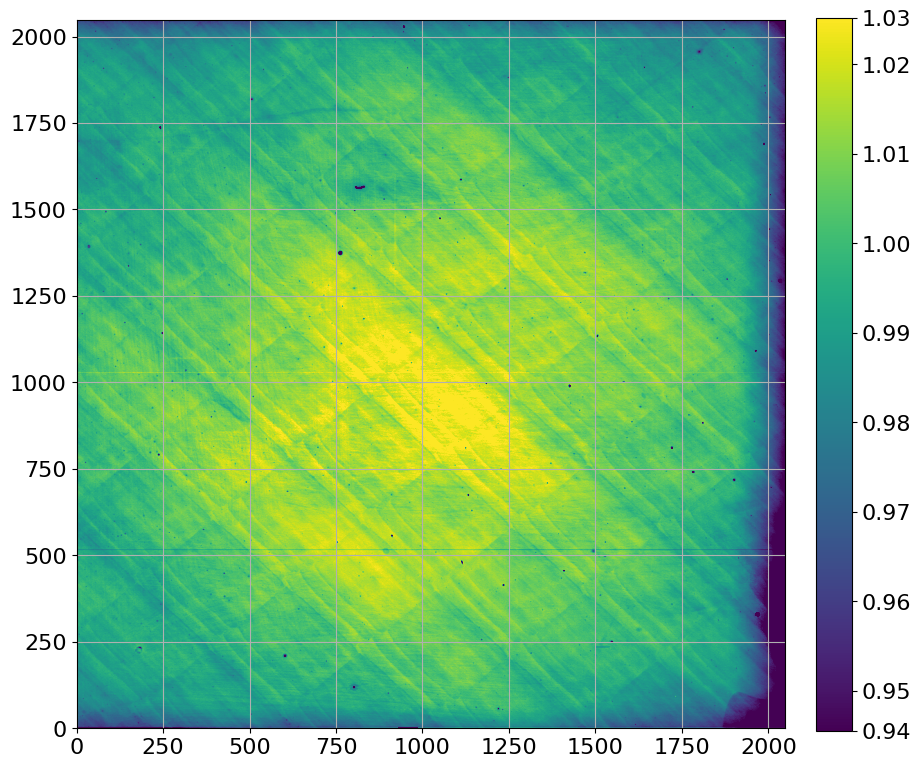

In [32]:
show_image(bmasterflat)

I picked B band flats for this calculation (for some variety?) and the first two bias frames. I calculated the sum and difference between flats and bias frames and made sure to use normalized flats for realistic gain and read noise. The rms and rms^2 (which had me undo a square root I did right before, oops) were calculated from the difference between frames. I have a gain and read noise that seem reasonable enough to me.

In [34]:
bflat1 = bscaled[0]
bflat1 = bflat1[1500:1700, 1500:1700]
bflat2 = bscaled[1]
bflat2 = bflat2[1500:1700, 1500:1700]
bflatsum = np.asarray(bflat1)+np.asarray(bflat2)
bflatdiff = np.asarray(bflat1)-np.asarray(bflat2)
bflatdiff_meansq = np.mean(np.asarray(bflatdiff)**2, axis=1)
bflatdiff_rms = np.sqrt(bflatdiff_meansq)
bflatdiff_rms_2 = bflatdiff_rms**2

biasframes = [data_dir+"a"+str(num).zfill(3)+".fits" for num in np.arange(93,95)] # forms a list of strings
biashdu = [fits.open(frame) for frame in biasframes]
biasdata = [hdu[0].data for hdu in biashdu]
bias1 = biasdata[0]
bias1 = bias1[1500:1700, 1500:1700]
bias2 = biasdata[1]
bias2 = bias2[1500:1700, 1500:1700]
biassum = bias1+bias2
biasdiff = bias1-bias2
biasdiff_meansq = np.mean(np.asarray(biasdiff)**2, axis=1)
biasdiff_rms = np.sqrt(biasdiff_meansq)
biasdiff_rms_2 = biasdiff_rms**2

gain=(bflatsum-biassum)/(bflatdiff_rms_2-biasdiff_rms_2)
print("gain", np.mean(gain), "electrons/ADU")

readnoise = (np.mean(gain)*biasdiff_rms)/(np.sqrt(2))
print("read noise", np.mean(readnoise))

gain 9.550602783927804 electrons/ADU
read noise 80.41956854051638
